# CS498PS - Lab 4: 3D Audio


In this lab we will learn how to create 3D sounds for headphone playback. We will make use of simple filters and HRTFs to create static and moving sources. Use the three sounds fly.wav, helicopter.wav, and crumble.wav in the lab archive as sources for the 3D recording that you will create.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io.wavfile import read, write
from scipy import signal
import math
import os
%matplotlib inline

## Part 1: Static sources using ITD/ILD cues

Assume the following source locations: 

- Straight ahead

- 45 degrees to the left

- 80 degrees to the right

- 160 degrees to the left

For each location find the source’s delay between the two ears (assume a source distance of 2 meters), and design two filters that will simulate that ITD and ILD features (feel free to round the IDT delays to an integer sample size). Assume that when sounds come from the side of the head the attenuation at the contralateral ear is by a factor of 0.7. From sounds coming medial plane (between the ears) there will be no attenuation due to the head. For positions moving from the medial plane towards the sides you can interpolate between no attenuation and a factor of 0.7. Design and plot the filters that correspond to the locations shown above and use them to make 3D sounds with the following sounds:

- Crumbling paper: [https://drive.google.com/uc?export=download&id=1bsZArYwMftsuCLdMknRomz4kAJWT-Uhv ]

- Fly: [https://drive.google.com/uc?export=download&id=1bswUsI28yJOUQuNLvNxq3pu9qj0bb8ne ]

- Helicopter: [https://drive.google.com/uc?export=download&id=1c8YhNNLmaO7CA2dJNCkBsB9MY0HjHDRL ]

Listen to the result through headphones and verify that they sound somewhat localized (it won’t sound perfect, but it should be believable).

In [2]:
# YOUR CODE HERE

# define hyperparameters
head_len = 0.1524
sound_spd = 343
dist_c = 2
    
# define functions
def sound( x, rate=8000, label=''):
    from IPython.display import display, Audio, HTML
    if label is '':
        display( Audio( x, rate=rate))
    else:
        display( HTML( 
        '<style> table, th, td {border: 0px; }</style> <table><tr><td>' + label + 
        '</td><td>' + Audio( x, rate=rate)._repr_html_()[3:] + '</td></tr></table>'
        ))
        
def get_distance(theta, ref):
    # compute distance to left and right ear(in m)
    angle = theta / 180 * np.pi
    base_c = np.cos(angle) * dist_c
    height = np.sin(angle) * dist_c
    sign = 1 if theta <= 90 else -1
    if ref=='left':
        base_l = abs(base_c) - sign * (head_len/2)
        base_r = abs(base_c) + sign * (head_len/2)
    else:
        base_l = abs(base_c) + sign * (head_len/2)
        base_r = abs(base_c) - sign * (head_len/2)
    dist_l = np.sqrt(height**2 + base_l**2)
    dist_r = np.sqrt(height**2 + base_r**2)
    
    return dist_l, dist_r
        
def get_delay(theta, Fs, ref):
    # compute delay
    dist_l, dist_r = get_distance(theta, ref)
    time_l = dist_l/sound_spd
    time_r = dist_r/sound_spd
    delay_l = int(time_l * Fs)
    delay_r = int(time_r * Fs)
    
    return delay_l, delay_r
    
def get_attenuation(theta):
    # compute attenuation
    k = (1-0.7)/90
    b = 0.7
    g = k * theta + b # attenuation factor
    
    return g

def get_filter(theta, Fs, ref='left'):
    delay_l, delay_r = get_delay(theta, Fs, ref)
    g = get_attenuation(theta)
    N = max(delay_l, delay_r) + 100
    filt_l = np.zeros(N)
    filt_r = np.zeros(N)
    if ref=='left':
        filt_l[delay_l] = 1
        filt_r[delay_r] = g
    else:
        filt_l[delay_l] = g
        filt_r[delay_r] = 1
    
    return filt_l, filt_r

crumble straight ahead


fly straight ahead


helicopter straight ahead


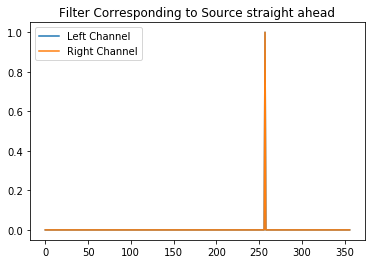

crumble 45 degrees to the left


fly 45 degrees to the left


helicopter 45 degrees to the left


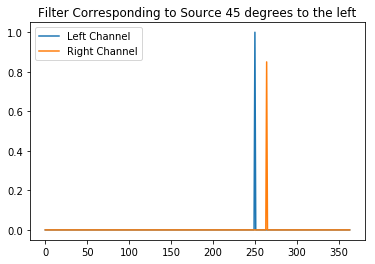

crumble 80 degrees to the right


fly 80 degrees to the right


helicopter 80 degrees to the right


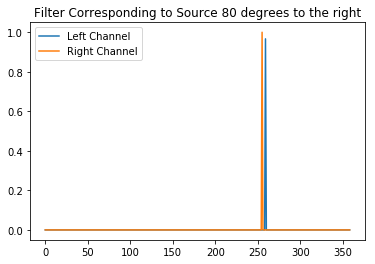

crumble 160 degrees to the left


fly 160 degrees to the left


helicopter 160 degrees to the left


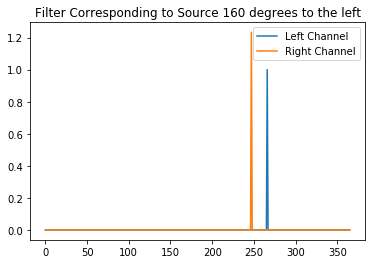

In [3]:
for theta, ref in zip([90, 45, 80, 160], ['left','left', 'right', 'left']):
    if theta==90:
        suffix = ' straight ahead'
    else:
        suffix = ' '+str(theta)+' degrees to the '+ref
    
    for f in ['crumble.wav', 'fly.wav', 'helicopter.wav']:
    
        Fs, wav_in = read(f)
        filt_l, filt_r = get_filter(theta, Fs, ref)
            
        channel_l = signal.lfilter(filt_l, [1], wav_in)
        channel_r = signal.lfilter(filt_r, [1], wav_in)
        wav_3d = np.vstack((channel_l, channel_r))
        sound(wav_3d, rate=Fs, label=os.path.splitext(f)[0]+suffix)
    
    plt.figure()
    plt.title('Filter Corresponding to Source'+suffix)
    plt.plot(filt_l, label='Left Channel')
    plt.plot(filt_r, label='Right Channel')
    plt.legend()
    plt.show()

## Part 2. Static sources using HRTFs

Download the HTTF archive from [https://drive.google.com/uc?export=download&id=1vFzSo-zlNFI-q2T9yvRRmOeZ-elZ8lW3 ]. In that directory you will also find code for the function load_hrtf which returns the left and right HRTF filters given as input a source’s azimuth and elevation. These filters will be much better than the ITD/ILD filters for localizing sounds.

Apply the HRTFs on the given sources and create 3D sounds that correspond to the locations given above. For each source, you will beed to convolve it with the left and right HRTF of the desired position and generate two sounds, one for each channel. Verify that they sound correct using headphones; are they better than before? What differences do you observe? When you use these make sure that the sample rates of the HRTFs and the sounds you convolve them with match.

In [4]:
# YOUR CODE HERE
def load_hrtf( ad, ed):
    # Return the HRTFs for a given azimuth and elevation
    #  function h,a,e = load_hrtf( ad, ed)
    #
    # Inputs:
    #   ad  is the azimuth to use in degrees (0 is front)
    #   ed  is the elevation to use in degrees (0 is level with ears)
    #
    # Output:
    #   l,r two 128pt arrays, first is left ear HRTF, second is right ear HRTF
#     from numpy import *


    # Path where the HRTFs are
    p = 'hrtf/compact'

    # Get nearest available elevation
    e = max( -40, min( 90, 10*(ed//10)))

    # Get nearest available azimuth
    ad = np.remainder( ad, 360)
    if ad > 180:
        ad = ad-360
    if ad < 0:
        a = abs( ad)
        fl = 1
    else:
        a = ad
        fl = 0
    a = max( 0, min( 180, 5*(a//5)))

    # Load appropriate response
    h = np.fromfile( '%s/elev%d/H%de%.3da.dat' % (p, e, e, a), dtype='>i2').astype( 'double')/32768
    if fl:
        return h[1::2],h[::2]
    else:
        return h[::2],h[1::2]

In [5]:
for ad, ed in zip([90, 90, 270, 270],[0,45,0,45]):

    suffix = ' at azimuth='+str(ad)+' and elevation='+str(ed)
    filt_l, filt_r = load_hrtf(ad, ed)

    for f in ['crumble.wav', 'fly.wav', 'helicopter.wav']:

        Fs, wav_in = read(f)

        channel_l = signal.lfilter(filt_l, [1], wav_in)
        channel_r = signal.lfilter(filt_r, [1], wav_in)
        wav_3d = np.vstack((channel_l, channel_r))
        sound(wav_3d, rate=Fs, label=os.path.splitext(f)[0]+suffix)
    print()

crumble at azimuth=90 and elevation=0


fly at azimuth=90 and elevation=0


helicopter at azimuth=90 and elevation=0


crumble at azimuth=90 and elevation=45


fly at azimuth=90 and elevation=45


helicopter at azimuth=90 and elevation=45


crumble at azimuth=270 and elevation=0


fly at azimuth=270 and elevation=0


helicopter at azimuth=270 and elevation=0


crumble at azimuth=270 and elevation=45


fly at azimuth=270 and elevation=45


helicopter at azimuth=270 and elevation=45


The results sound better than previous method. Specifically, we can now model sound source not only from different azimuth angles, but from different elevations as well. By playing the outputs with headphones, we can distinguish sources at different horizontal and vertical positions.

## Part 3. Dynamic Sources with HRTFs

In this part you will need to make a moving sound source. In order to do so we will make use of a fast convolution routine based on your STFT code from lab 1 (ha, you thought you were done with that!). In order to perform fast convolution we can perform an STFT of the sound to use, multiply each time frame of this transform with the DFT of the filter that we want  to impose and then use overlap add to transform back to the time domain.

Start by taking each sound from above, and apply your STFT on it. Make sure that the size of the transform is the same as the HRTF’s filter length. The hop size should be the same as the DFT size and you will need to zero pad by as much as the DFT size in order to facilitate the tail of the convolution. Do not use an analysis/synthesis window.

Once you compute this STFT, go through its every time frame and element-wise multiply it with the desired HRTF filter to generate the STFT of the left and right sounds. Figure out which HRTF angle to multiply each frame with so that by the end of the sound you will have made it go around your head.

Once you perform these operations you will have generated two STFT matrices, one for the left channel and one for the right. Use your inverse STFT routine and play the stereo sound through your headphones. You should hear a convincing rendering of the original sounds circling around your head.

In [6]:
# YOUR CODE HERE
# raise NotImplementedError()
def stft(input_sound, ed, F=128):
    L = len(input_sound)
    num_frame = L//F
    tail = L-num_frame*F
    if tail > 0:
        pad = F - tail
        input_sound = np.pad(input_sound, (0, pad), 'constant')
        num_frame += 1
    stft_l = np.zeros((num_frame, F+1)).astype(complex)
    stft_r = np.zeros((num_frame, F+1)).astype(complex)
    ads = np.linspace(0, 360, num_frame)
    for i, ad in zip(range(num_frame), ads):
        # get output frame
        input_f = input_sound[i*F:(i+1)*F].astype(float)
        output_f = np.pad(input_f, (0, F), 'constant')
        
        # get fft of zero-pad filters
        filt_l, filt_r = load_hrtf(ad, ed)
        filt_l = np.pad(filt_l, (0, F), 'constant')
        filt_r = np.pad(filt_r, (0, F), 'constant')
        fft_l = np.fft.rfft(filt_l)
        fft_r = np.fft.rfft(filt_r)
                      
        # element-wise multiplied by the filters
        output_f_l = np.fft.rfft(output_f) * fft_l
        output_f_r = np.fft.rfft(output_f) * fft_r
        stft_l[i, :] = output_f_l
        stft_r[i, :] = output_f_r
        
    return stft_l.T, stft_r.T

def istft(stft, F=128):
    T = stft.shape[1]
    L = T*F
    x = np.zeros(L+F)
    for t in range(T):
        curr_frame = stft[:, t]
        ifft = np.fft.irfft(curr_frame)
        idx = t*F
        x[idx:idx+2*F] += ifft
        
    return x

def dynamic_hrtfs(wav_in, ed=20):
    stft_l, stft_r = stft(wav_in, ed=ed)
    channel_l = istft(stft_l)
    channel_r = istft(stft_r)
    dynamic_wav_3d = np.vstack((channel_l, channel_r))
    
    return dynamic_wav_3d

In [7]:
for f in ['crumble.wav', 'fly.wav', 'helicopter.wav']:
    suffix=' at elevation=20'
    
    Fs, wav_in = read(f)
    dynamic_wav_3d = dynamic_hrtfs(wav_in)
    sound(dynamic_wav_3d, rate=Fs, label='dynamic '+os.path.splitext(f)[0]+suffix)

dynamic crumble at elevation=20


dynamic fly at elevation=20


dynamic helicopter at elevation=20


## Part 4. Extra credit (required for 4-hour credit registrants)

Use the file in [https://drive.google.com/uc?export=download&id=1bxQkXcGa57S3G7IRWu9urS-jCPdf5Pif ] to make a short story. This is a 7-channel file of a scene from a really bad B-movie. Each channel contains a different sound. If you play that sound you probably won’t hear most of the content since you won’t have a 7 speaker setup, import it in a multi-channel editor such as Audacity and you will get a sense of what’s in there. Since it sounds so boring you need to add some reverb and 3D-locate the sounds so that it sounds more exciting. Try to make it sound better using what we have done so far. Keep in mind that you can add different amounts of reverb for each sound, and you can dynamically 3D place them as well.

In [8]:
def get_comb_filter(N, g):
    b = np.zeros(N+1)
    a = np.zeros(N+1)
    b[0] = 1
    a[0] = 1
    a[-1] = -g
    return b, a

def get_allpass_filter(N, g):
    b = np.zeros(N+1)
    a = np.zeros(N+1)
    b[0] = g
    b[-1] = 1
    a[0] = 1
    a[-1] = g
    return b, a

def schroeder(data):
    Ns = [450, 2500, 1025, 150, 385, 3500]
    gs = [.6, .8, .6, .4, .7, .7]
    wetness = 1.5
    output = None
    for i, N, g in zip(range(6), Ns, gs):
        if i < 4:
            b, a = get_comb_filter(N, g)
            if output is None:
                output = signal.lfilter(b, a, data)
            else:
                output += signal.lfilter(b, a, data)
        else:
            b, a = get_allpass_filter(N, g)
            output = signal.lfilter(b, a, output)

    output = output + data * wetness
    return output

In [10]:
# YOUR CODE HERE
# raise NotImplementedError()
Fs, wav_in=read('dry.wav')

wav_out = None
for i, angle in zip(range(7), [[45,10],[135,20],[180,-10],[270,-20],[0,90],[215,-20],[90,0]]):
    ad, ed = angle[0], angle[1]
    filt_l, filt_r = load_hrtf(ad, ed)
    temp_wav_out = schroeder(wav_in[:,i])
    channel_l = signal.lfilter(filt_l, [1], temp_wav_out)
    channel_r = signal.lfilter(filt_r, [1], temp_wav_out)
    if wav_out is None:
        wav_out = np.vstack((channel_l, channel_r))
    else:
        wav_out = np.vstack((wav_out, channel_l, channel_r))

wav_out /= np.max(wav_out)
# sound(wav_out, rate=Fs, label='exciting!')
write('exciting.wav', Fs, wav_out.T)